<a href="https://colab.research.google.com/github/jpscard/Yolov12_Projects/blob/main/02_YOLOv12_EPI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***Treinamento de modelos YOLOv12***

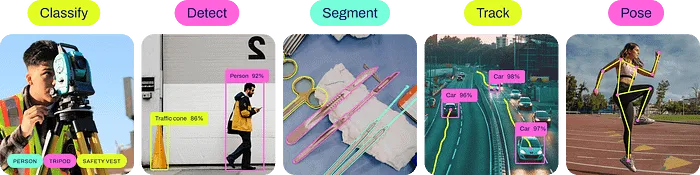

## ***Como treinar o modelo de detecção de objetos YOLOv12 em um conjunto de dados personalizado?***

## ***1. Instalar todos os pacotes necessários***

In [1]:
!nvidia-smi  # Exibe informações detalhadas sobre a GPU disponível, como o modelo, uso de memória, temperatura e processos em execução

Fri Apr 25 22:06:17 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   56C    P8             11W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install ultralytics -q  # Instala o pacote 'ultralytics', que fornece ferramentas para detecção de objetos e modelos como YOLOv8
!pip install roboflow -q  # Instala o pacote 'roboflow', que facilita o acesso a datasets, treinamento de modelos e integração com a plataforma Roboflow

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 984.0/984.0 kB 16.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 62.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 65.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 38.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 102.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.2/85.2 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

## ***2. Importar todas as bibliotecas necessárias***

In [3]:
import os  # Importa o módulo 'os' para interagir com o sistema de arquivos, como manipulação de diretórios e arquivos

from ultralytics import YOLO  # Importa a classe 'YOLO' da biblioteca 'ultralytics', que permite carregar e usar modelos de detecção como YOLOv8

from IPython.display import Image  # Importa a função 'Image' para exibir imagens em notebooks (como Jupyter ou Colab)

import ultralytics  # Importa a biblioteca 'ultralytics' inteira, que oferece várias funções auxiliares para trabalhar com modelos de detecção

ultralytics.checks()  # Executa uma verificação de integridade da instalação da biblioteca 'ultralytics', checando se os requisitos estão corretos

Ultralytics 8.3.116 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 41.3/112.6 GB disk)


## ***3. Baixar conjunto de dados do Roboflow***

In [4]:
HOME = os.getcwd()  # Obtém o diretório de trabalho atual (onde o script está sendo executado) e armazena em 'HOME'
print(HOME)  # Exibe o caminho do diretório de trabalho atual no console

/content


https://universe.roboflow.com/project-uyrxf/ppe_detection-v1x3l/dataset/2

In [5]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="hzoVrDHDbdeFNRLoh2Nq")
project = rf.workspace("project-uyrxf").project("ppe_detection-v1x3l")
version = project.version(2)
dataset = version.download("yolov12")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to PPE_Detection-2 in yolov12:: 100%|██████████| 6472/6472 [00:02<00:00, 3037.79it/s]


In [6]:
!ls {dataset.location}

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


## ***4. Ajuste fino do modelo YOLOv12 em um conjunto de dados personalizado***

***Precisamos fazer algumas alterações em nosso conjunto de dados baixado para que ele funcione com o YOLOv12. Execute os seguintes comandos bash para preparar seu conjunto de dados para treinamento, atualizando os caminhos relativos no arquivo `data.yaml`, garantindo que ele aponte corretamente para os subdiretórios`train`, `test`, e `valid` do seu conjunto de dados.***

In [7]:
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!sed -i '$d' {dataset.location}/data.yaml
!echo -e "test: ../test/images\ntrain: ../train/images\nval: ../valid/images" >> {dataset.location}/data.yaml

In [8]:
!cat {dataset.location}/data.yaml

train: ../train/images
val: ../valid/images
test: ../test/images

nc: 7
names: ['Dust Mask', 'Eye Wear', 'Glove', 'Protective Boots', 'Protective Helmet', 'Safety Vest', 'Shield']

roboflow:
  workspace: project-uyrxf
test: ../test/images
train: ../train/images
val: ../valid/images


- ***Agora estamos prontos para ajustar nosso modelo YOLOv12. No código abaixo, inicializamos o modelo usando um ponto de verificação inicial — aqui, usamos `yolov12s.yaml`, mas você pode substituí-lo por qualquer outro modelo (por exemplo, `yolov12n.pt`, `yolov12m.pt`, `yolov12l.pt`, ou `yolov12x.pt`) de acordo com sua preferência.***

- ***Configuramos o treinamento para ser executado por 50 períodos neste exemplo; no entanto, você deve ajustar o número de períodos, juntamente com outros hiperparâmetros, como tamanho do lote, tamanho da imagem e configurações de aumento (escala, mosaico, mixagem e copiar e colar), com base nos recursos do seu hardware e no tamanho do conjunto de dados.***

- ***Observação: Observe que, após o treinamento, você poderá encontrar o erro `TypeError: argument of type 'PosixPath' is not iterable error` — este é um problema conhecido, mas os pesos do seu modelo ainda serão salvos, para que você possa prosseguir com segurança para a execução da inferência.***

In [9]:
model = YOLO("yolo12s.yaml")

In [10]:
results = model.train(data=f'{dataset.location}/data.yaml', epochs=20)

Ultralytics 8.3.116 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo12s.yaml, data=/content/PPE_Detection-2/data.yaml, epochs=20, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True, l

100%|██████████| 755k/755k [00:00<00:00, 14.2MB/s]

Overriding model.yaml nc=80 with nc=7

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  3                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  4                  -1  1    103360  ultralytics.nn.modules.block.C3k2            [128, 256, 1, False, 0.25]    
  5                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  6                  -1  2    689408  ultralytics.nn.modules.block.A2C2f           [256, 256, 2, True, 4]        
  7                  -1  1   1180672  ultralytics

 20                  -1  1   1511424  ultralytics.nn.modules.block.C3k2            [768, 512, 1, True]           
 21        [14, 17, 20]  1    822117  ultralytics.nn.modules.head.Detect           [7, [128, 256, 512]]          
YOLO12s summary: 272 layers, 9,255,845 parameters, 9,255,829 gradients, 21.5 GFLOPs

Freezing layer 'model.21.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks...


100%|██████████| 5.35M/5.35M [00:00<00:00, 66.1MB/s]


AMP: checks passed ✅
train: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1789.3±775.3 MB/s, size: 66.1 KB)


train: Scanning /content/PPE_Detection-2/train/labels... 2271 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2271/2271 [00:00<00:00, 2387.86it/s]

train: New cache created: /content/PPE_Detection-2/train/labels.cache


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 975.2±691.6 MB/s, size: 95.2 KB)


val: Scanning /content/PPE_Detection-2/valid/labels... 637 images, 0 backgrounds, 0 corrupt: 100%|██████████| 637/637 [00:00<00:00, 1189.44it/s]

val: New cache created: /content/PPE_Detection-2/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000909, momentum=0.9) with parameter groups 113 weight(decay=0.0), 120 weight(decay=0.0005), 119 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/train
Starting training for 20 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/20      5.98G      3.905        4.8      4.122         98        640: 100%|██████████| 142/142 [01:06<00:00,  2.13it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:09<00:00,  2.04it/s]

                   all        637       3064   0.000965       0.13   0.000949   0.000253



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/20      6.78G      3.169      4.013      3.315         77        640: 100%|██████████| 142/142 [01:04<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.29it/s]

                   all        637       3064      0.277      0.216     0.0902      0.031



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/20      6.82G      2.599      3.156      2.678        144        640: 100%|██████████| 142/142 [01:03<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.41it/s]

                   all        637       3064      0.735      0.244      0.287      0.132



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/20      6.86G      2.294      2.601      2.331        111        640: 100%|██████████| 142/142 [01:04<00:00,  2.20it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.30it/s]

                   all        637       3064      0.759      0.307      0.356      0.183



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/20       6.9G      2.113      2.315      2.149        116        640: 100%|██████████| 142/142 [01:03<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.38it/s]

                   all        637       3064      0.787      0.347      0.423      0.215



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/20      6.94G      2.004      2.126      2.044         97        640: 100%|██████████| 142/142 [01:03<00:00,  2.22it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:07<00:00,  2.56it/s]

                   all        637       3064      0.812      0.377      0.447      0.244



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/20      6.98G      1.904      1.958      1.932        111        640: 100%|██████████| 142/142 [01:03<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.36it/s]

                   all        637       3064      0.758      0.452      0.513       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/20      7.02G      1.836      1.849      1.882         87        640: 100%|██████████| 142/142 [01:03<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.38it/s]

                   all        637       3064      0.783      0.485      0.552      0.307



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/20      7.05G      1.767      1.738      1.805        127        640: 100%|██████████| 142/142 [01:03<00:00,  2.23it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:07<00:00,  2.55it/s]

                   all        637       3064       0.79      0.514      0.579      0.335



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/20      7.09G      1.728      1.691      1.787         81        640: 100%|██████████| 142/142 [01:03<00:00,  2.24it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.38it/s]

                   all        637       3064      0.777      0.532      0.596      0.344


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/20      7.13G      1.622      1.515      1.726         74        640: 100%|██████████| 142/142 [01:04<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.37it/s]

                   all        637       3064      0.818      0.561      0.631       0.37



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/20      7.17G      1.589      1.421      1.693         66        640: 100%|██████████| 142/142 [01:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:07<00:00,  2.55it/s]

                   all        637       3064      0.853      0.573      0.659      0.391



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/20      7.21G      1.548      1.356       1.65         71        640: 100%|██████████| 142/142 [01:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.37it/s]

                   all        637       3064      0.843      0.585       0.66      0.388



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/20      7.25G      1.513      1.302      1.627         69        640: 100%|██████████| 142/142 [01:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:07<00:00,  2.60it/s]

                   all        637       3064      0.878      0.591       0.69      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/20      7.29G      1.471      1.242       1.59         74        640: 100%|██████████| 142/142 [01:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.39it/s]

                   all        637       3064      0.877      0.609      0.704      0.422



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/20      7.32G      1.445      1.206      1.562         63        640: 100%|██████████| 142/142 [01:03<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:07<00:00,  2.51it/s]

                   all        637       3064      0.881      0.608      0.715      0.437



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/20      7.36G      1.414       1.17      1.543         69        640: 100%|██████████| 142/142 [01:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.44it/s]

                   all        637       3064       0.87       0.63      0.715      0.439



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/20      6.15G      1.403      1.137      1.523         63        640: 100%|██████████| 142/142 [01:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.42it/s]

                   all        637       3064      0.881      0.634      0.727       0.45



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/20       6.9G      1.375      1.124      1.503         57        640: 100%|██████████| 142/142 [01:03<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:07<00:00,  2.61it/s]

                   all        637       3064      0.881      0.642      0.734      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/20       6.9G      1.354      1.097      1.502         74        640: 100%|██████████| 142/142 [01:02<00:00,  2.26it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:08<00:00,  2.40it/s]

                   all        637       3064        0.9      0.642      0.738      0.461



20 epochs completed in 0.404 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 18.9MB
Optimizer stripped from runs/detect/train/weights/best.pt, 18.9MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.116 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 20/20 [00:10<00:00,  1.88it/s]


                   all        637       3064        0.9      0.642      0.738      0.461
             Dust Mask        299        308      0.958      0.811      0.867      0.563
              Eye Wear        146        147      0.791      0.514      0.616      0.335
                 Glove        346        631      0.886      0.796      0.849      0.512
      Protective Boots        298        608       0.91      0.913      0.954      0.627
     Protective Helmet        403        753      0.921      0.765      0.878      0.595
           Safety Vest        359        592      0.833        0.7        0.8      0.509
                Shield         25         25          1          0      0.202     0.0841
Speed: 0.2ms preprocess, 8.0ms inference, 0.0ms loss, 2.2ms postprocess per image
Results saved to runs/detect/train


## ***5. Avaliar o modelo YOLOv12 ajustado***


In [13]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!ls {HOME}/runs/detect/train/

args.yaml			 R_curve.png	      train_batch2.jpg
confusion_matrix_normalized.png  results.csv	      val_batch0_labels.jpg
confusion_matrix.png		 results.png	      val_batch0_pred.jpg
F1_curve.png			 train_batch0.jpg     val_batch1_labels.jpg
labels_correlogram.jpg		 train_batch1420.jpg  val_batch1_pred.jpg
labels.jpg			 train_batch1421.jpg  val_batch2_labels.jpg
P_curve.png			 train_batch1422.jpg  val_batch2_pred.jpg
PR_curve.png			 train_batch1.jpg     weights


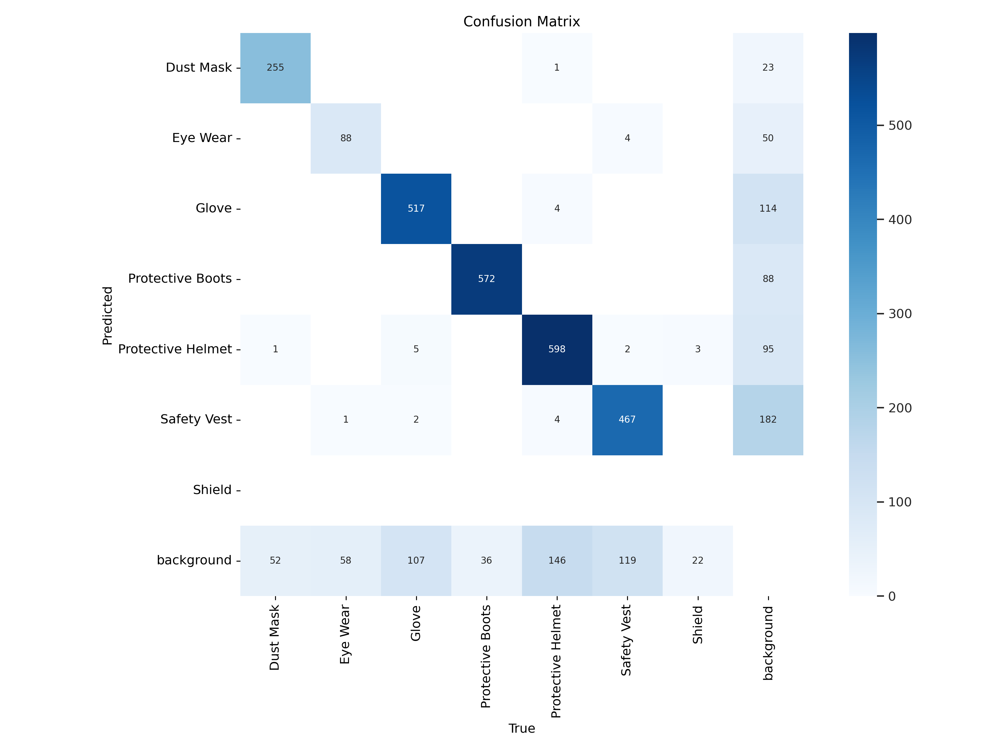

In [14]:
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=1000)

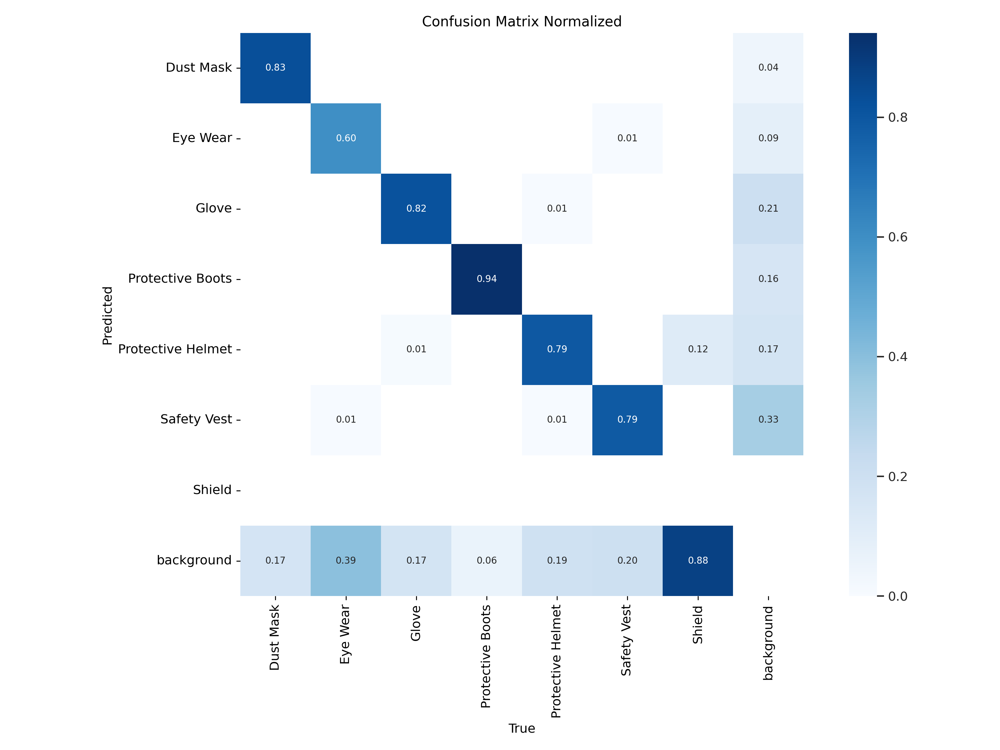

In [15]:
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix_normalized.png', width=1000)

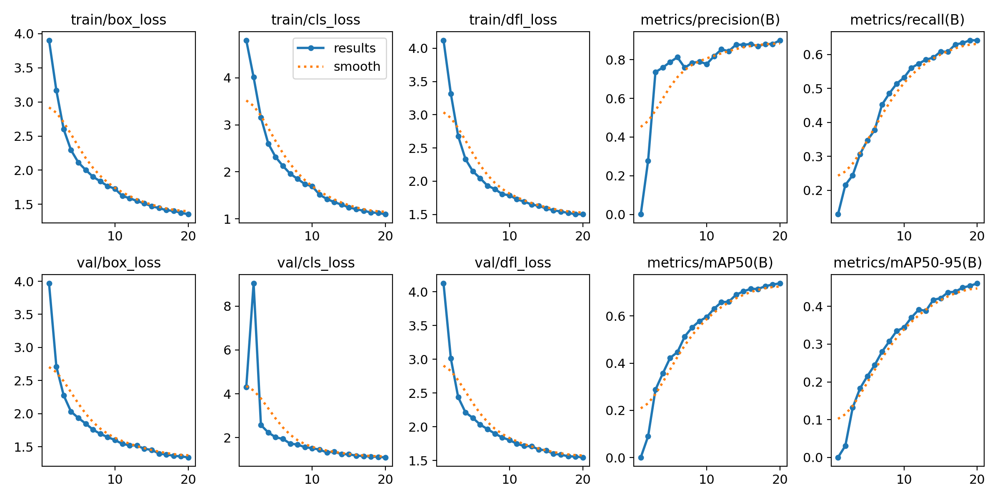

In [16]:
Image(filename=f'{HOME}/runs/detect/train/results.png', width=1000)

***Precision = TP / (TP + FP)***

***Precisão é simplesmente o número de verdadeiros positivos dentre o total de detecções***


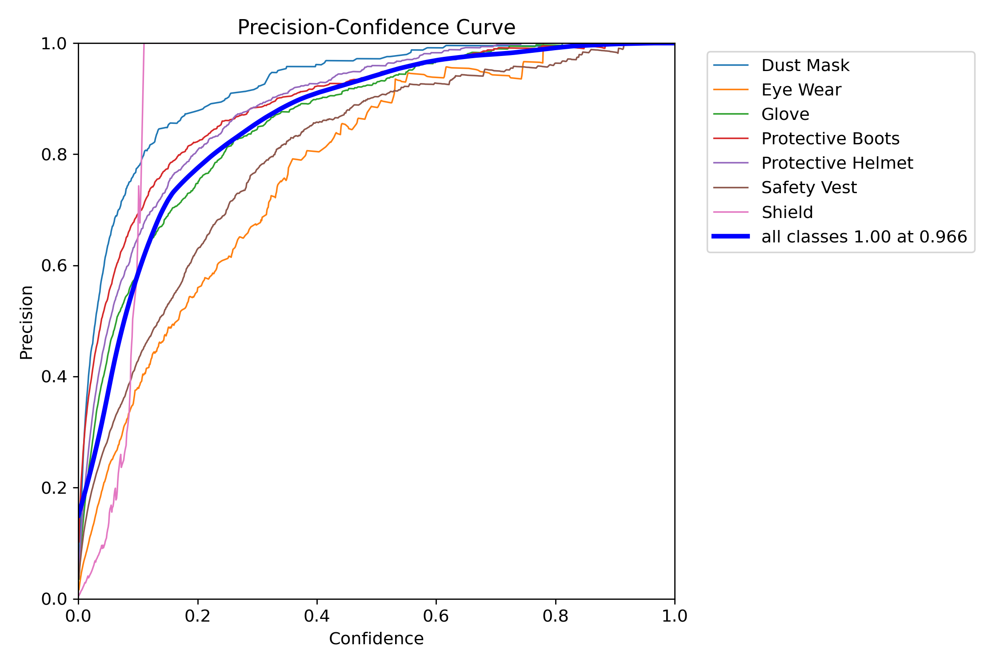

In [17]:
Image(filename=f'{HOME}/runs/detect/train/P_curve.png', width=1000)

***Recall = TP / (TP + FN)***

***Recall é a métrica dos verdadeiros positivos encontrados corretamente.***

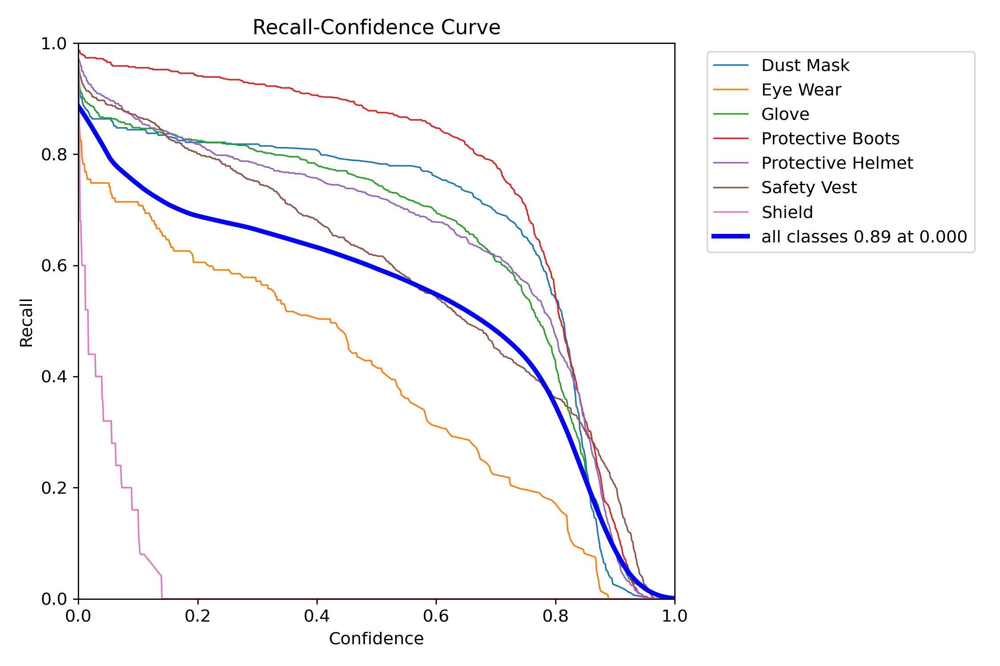

In [18]:
Image(filename=f'{HOME}/runs/detect/train/R_curve.png', width=1000)

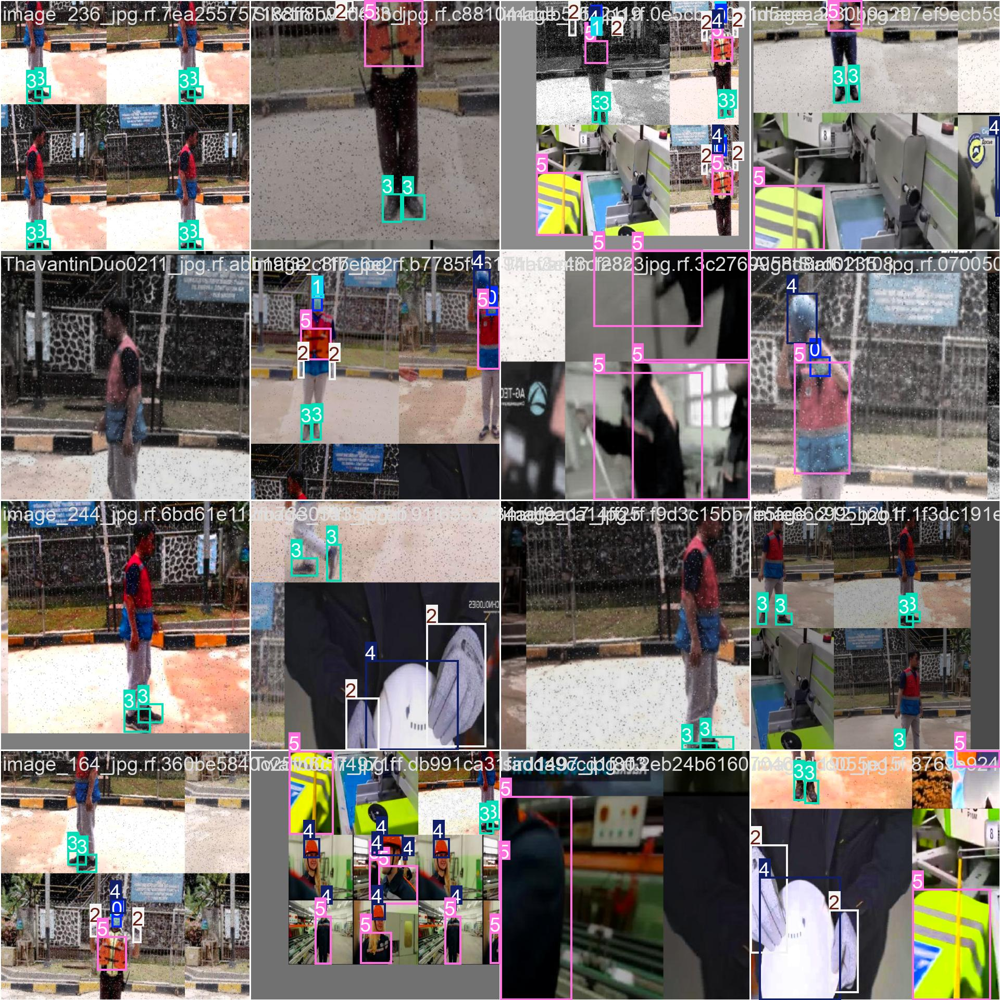

In [19]:
Image(filename=f'{HOME}/runs/detect/train/train_batch0.jpg', width=1000)

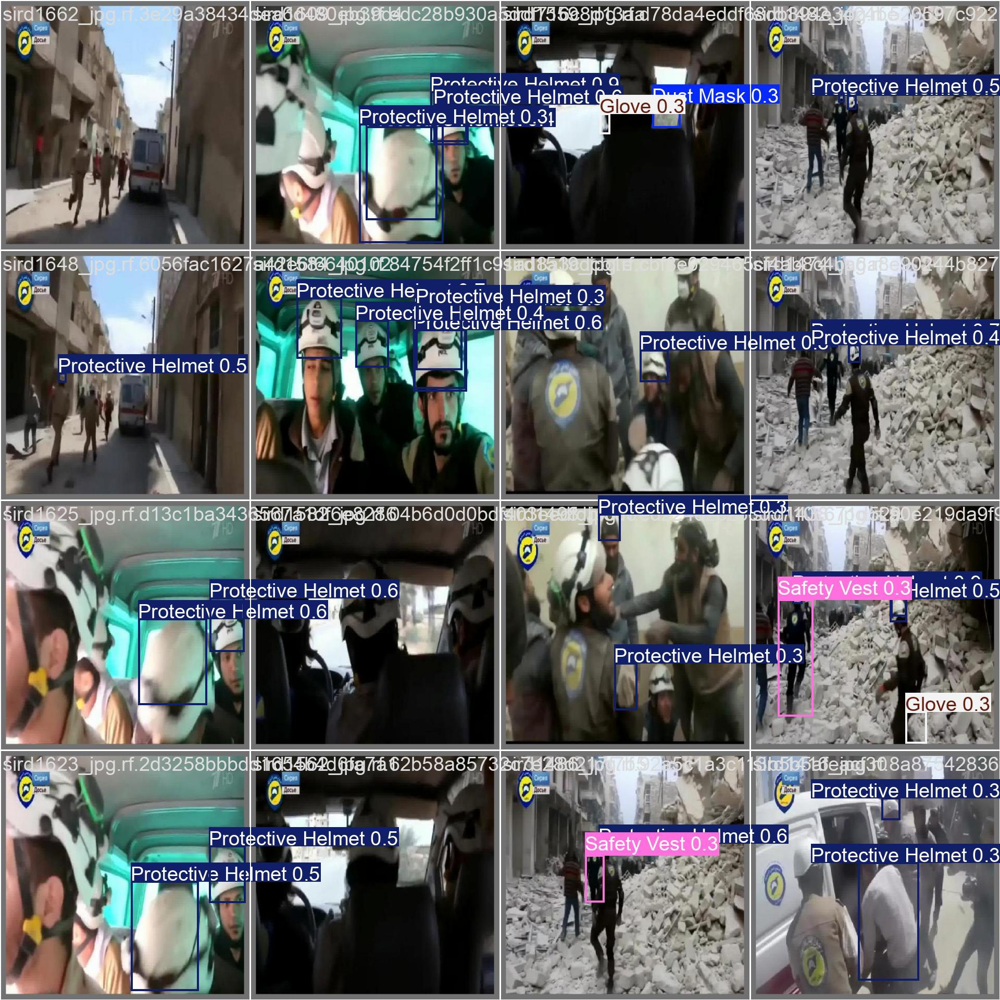

In [20]:
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=1000)

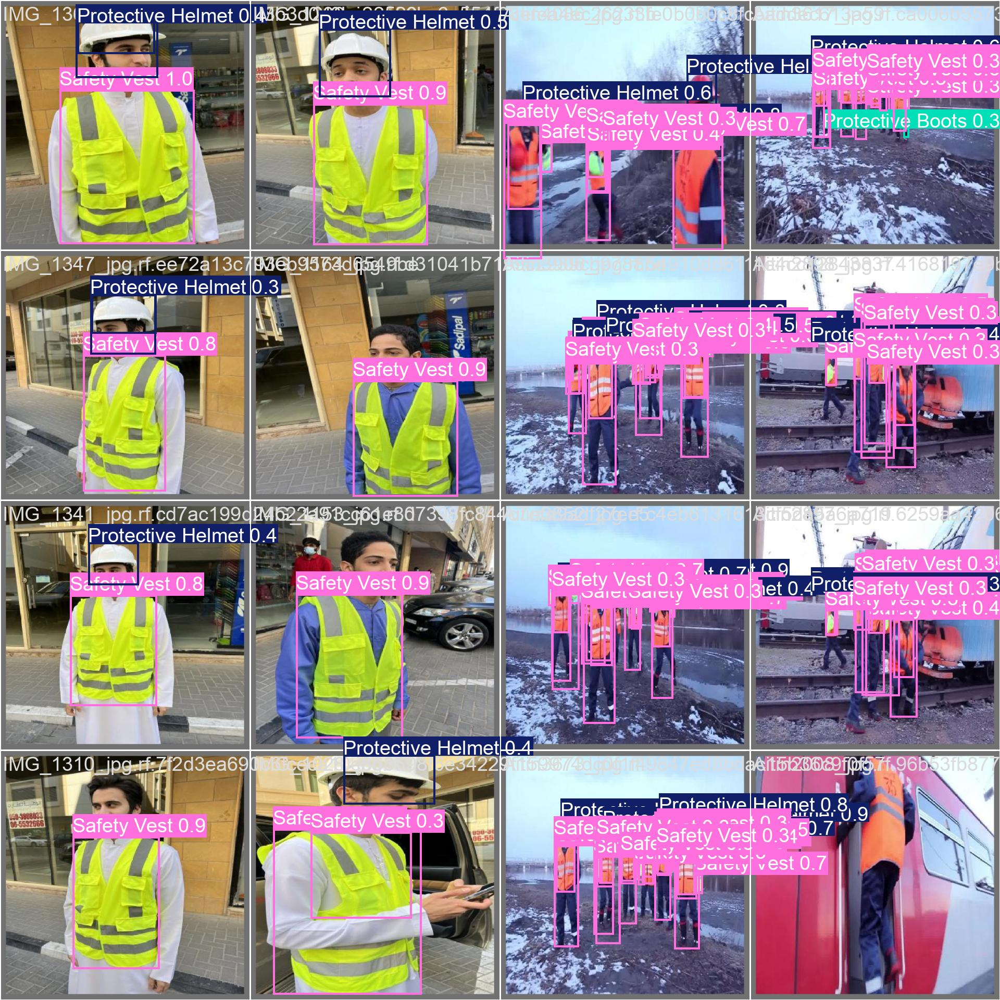

In [21]:
Image(filename=f'{HOME}/runs/detect/train/val_batch1_pred.jpg', width=1000)

## ***6. Baixe os Pesos do Modelo do Google Drive***

In [22]:
!gdown "https://drive.google.com/uc?id=1ka7Gj8RE6iP8-ExtigZJhmiyr5k5lqRQ&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1ka7Gj8RE6iP8-ExtigZJhmiyr5k5lqRQ&confirm=t
To: /content/best.pt
100% 18.9M/18.9M [00:00<00:00, 46.7MB/s]


## ***7. Validar modelo ajustado***

In [23]:
model = YOLO("best.pt")  # load a custom model

# Validate the model
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map  # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps  # a list contains map50-95 of each category

Ultralytics 8.3.116 🚀 Python-3.11.12 torch-2.6.0+cu124 CUDA:0 (Tesla T4, 15095MiB)
YOLO12s summary (fused): 159 layers, 9,233,589 parameters, 0 gradients, 21.2 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1725.8±544.3 MB/s, size: 67.6 KB)


val: Scanning /content/PPE_Detection-2/valid/labels.cache... 637 images, 0 backgrounds, 0 corrupt: 100%|██████████| 637/637 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 40/40 [00:13<00:00,  2.94it/s]


                   all        637       3064      0.854      0.736      0.797      0.521
             Dust Mask        299        308      0.942      0.834      0.896      0.596
              Eye Wear        146        147      0.709      0.667      0.706      0.377
                 Glove        346        631      0.882      0.853      0.893       0.58
      Protective Boots        298        608      0.865      0.956      0.972      0.666
     Protective Helmet        403        753      0.859      0.866      0.919      0.656
           Safety Vest        359        592      0.724      0.829      0.847      0.595
                Shield         25         25          1      0.146      0.343      0.174
Speed: 0.7ms preprocess, 14.2ms inference, 0.0ms loss, 1.3ms postprocess per image
Results saved to runs/detect/val


array([    0.59551,     0.37706,     0.57954,     0.66606,     0.65597,     0.59547,     0.17393])

## ***8. Inferência com modelo personalizado em imagens***

In [24]:
dataset.location

'/content/PPE_Detection-2'

In [25]:
results = model.predict(source = f"{dataset.location}/test/images", save = True)


image 1/322 /content/PPE_Detection-2/test/images/000446_jpg.rf.63a960737ed4b762294eea1ad1a92791.jpg: 640x640 3 Protective Helmets, 20.9ms
image 2/322 /content/PPE_Detection-2/test/images/20220721_161946_jpg.rf.905c375aa964159f9edab2a55a6e7476.jpg: 640x640 1 Protective Helmet, 20.9ms
image 3/322 /content/PPE_Detection-2/test/images/20220721_162015_jpg.rf.ccb5d8a5aed0bb50c04431fa0b0d5479.jpg: 640x640 1 Protective Helmet, 20.9ms
image 4/322 /content/PPE_Detection-2/test/images/20220721_162036_jpg.rf.2664c2f59604cd2380a51fd174055a7e.jpg: 640x640 1 Protective Helmet, 20.0ms
image 5/322 /content/PPE_Detection-2/test/images/20220721_162308_jpg.rf.913971a6c64f38eabc6b69bab4409b46.jpg: 640x640 (no detections), 19.7ms
image 6/322 /content/PPE_Detection-2/test/images/20220721_162435_jpg.rf.d478427044384d4e32ba0c25b15b720d.jpg: 640x640 (no detections), 19.7ms
image 7/322 /content/PPE_Detection-2/test/images/20220721_162444_jpg.rf.107652f17f526c25f74bb7b181c46717.jpg: 640x640 1 Protective Helmet, 

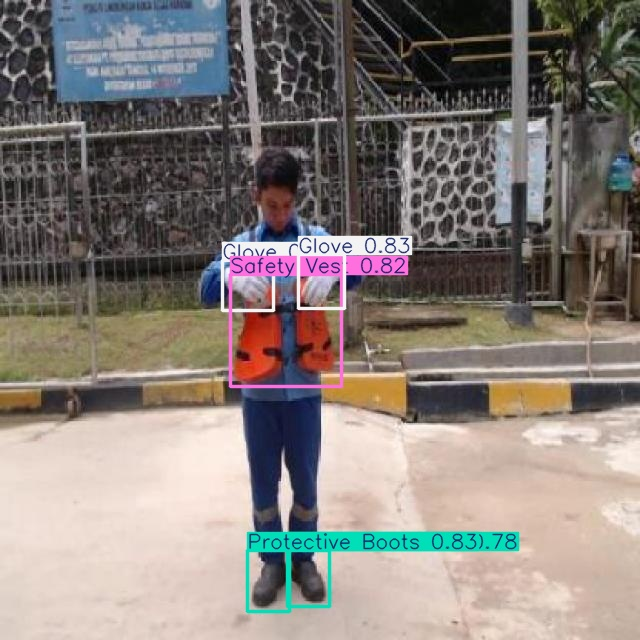

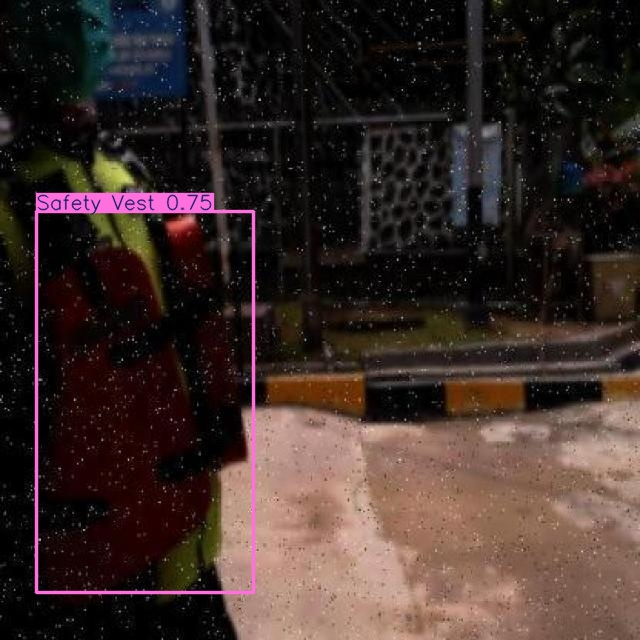

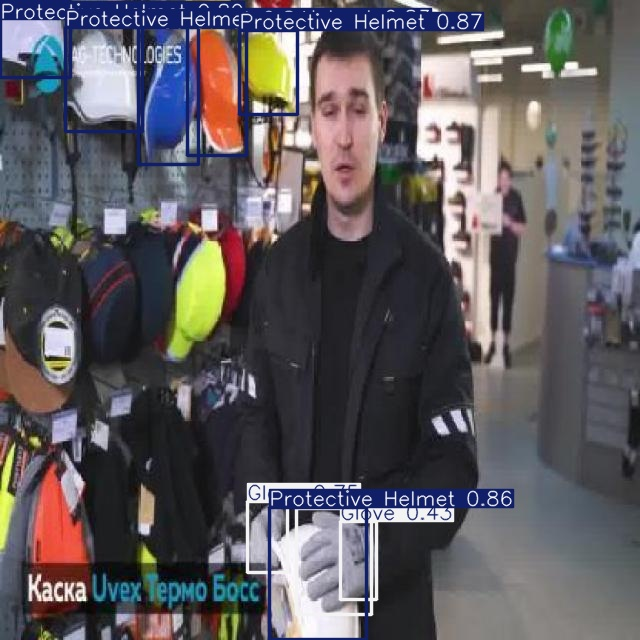

In [26]:
import glob
import os
from IPython.display import Image as IPyImage, display

latest_folder = max(glob.glob(f'{HOME}/runs/detect/predict*/'), key=os.path.getmtime)
for img in glob.glob(f'{latest_folder}/*.jpg')[2:5]:
    display(IPyImage(filename=img, width=600))
    print("\n")

### ***9. Inferência com modelo personalizado em vídeos***

In [27]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [28]:
!gdown "https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1Nyl18zr7zOJHh8uHtSic3dsJSY4LI_t-&confirm=t
To: /content/PPE_Part1.mp4
100% 14.2M/14.2M [00:00<00:00, 77.3MB/s]


In [29]:
!gdown "https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1SxcrDanPAr-PZfJjWBxoa2t8lUSM2dZn&confirm=t
To: /content/PPE_Part2.mp4
100% 11.1M/11.1M [00:00<00:00, 241MB/s]


In [30]:
results = model.predict(source = f"/{HOME}/PPE_Part1.mp4", save = True)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/310) //content/PPE_Part1.mp4: 384x640 (no detections), 84.7ms
video 1/1 (frame 2/310) //content/PPE_Part1.mp4: 384x640 1 Safety Vest, 21.9ms
video 1/1 (frame 3/310) //content/PPE_Part1.mp4: 384x640 (no detections), 22.3ms
video 1/1 (frame 4/310) //content/PPE_Part1.mp4: 384x640 (no detections), 21.0ms
video 1/1 (frame 5/310) //content/PPE_Part1.mp4: 384x640 (no detections), 21.5ms
video 1/1 (frame 6/310) //content/PPE_Part1.mp4: 384x

In [31]:
!rm '/content/result_compressed.mp4'

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [32]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = f'{HOME}/runs/detect/predict/PPE_Part1.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [33]:
results = model.predict(source = f"/{HOME}/PPE_Part2.mp4", save = True)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/267) //content/PPE_Part2.mp4: 384x640 (no detections), 16.0ms
video 1/1 (frame 2/267) //content/PPE_Part2.mp4: 384x640 (no detections), 19.9ms
video 1/1 (frame 3/267) //content/PPE_Part2.mp4: 384x640 (no detections), 17.3ms
video 1/1 (frame 4/267) //content/PPE_Part2.mp4: 384x640 (no detections), 17.2ms
video 1/1 (frame 5/267) //content/PPE_Part2.mp4: 384x640 (no detections), 21.1ms
video 1/1 (frame 6/267) //content/PPE_Part2.mp4: 38

In [34]:
!rm '/content/result_compressed.mp4'

In [35]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = f'{HOME}/runs/detect/predict/PPE_Part2.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=800 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)